In [1]:
import sys
import numpy as np
import pandas as pd
import librosa as lr
import librosa.display as lrd
import matplotlib.pyplot as plt
import seaborn as sb
from vscode_audio import Audio
from pydub import AudioSegment, effects
import noisereduce as nr
from tqdm import tqdm
from sklearn.utils import shuffle
from tqdm import tqdm
from audiomentations import Compose, AddGaussianNoise, TimeStretch, PitchShift, Shift, Gain, PolarityInversion, TimeMask, FrequencyMask, SpecFrequencyMask, RoomSimulator, AddBackgroundNoise
import os
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [2]:
# total_length = 423936
# total_length = 208384
# total_length = 70656
max_length = 24000
window_size = 2048
hop_length = 512
TOP_DB = 25
RATE = 16000


In [3]:
def get_emotion_identifier(emotion):
    if emotion == 'neutral' or emotion == '01':
        return 0
    elif emotion == 'calm' or emotion == '02':
        return 1
    elif emotion == 'happy' or emotion == '03':
        return 2
    elif emotion == 'sad' or emotion == '04':
        return 3
    elif emotion == 'angry' or emotion == '05':
        return 4
    elif emotion == 'fearful' or emotion == 'fear' or emotion == '06':
        return 5
    elif emotion == 'disgust' or emotion == '07':
        return 6
    elif emotion == 'surprised' or emotion == 'surprise' or emotion == 'ps' or emotion == '08':
        return 7
    else:
        raise ValueError('Emotion not found')

### RAVDESS

In [33]:
def get_df_from_path(path):
    files = []
    emo = []
    segment_lengths = []

    for dirpath, dirnames, filenames in os.walk(path):
        for filename in tqdm(filenames):

            splits = filename.split('_')

            sound = os.path.join(dirpath, filename)

            emotion = get_emotion_identifier(splits[0])

            files.append(sound)
            emo.append(emotion)

            data, _ = lr.load(sound, sr=RATE, res_type='kaiser_best')
            segment_lengths.append(len(data))
    
    
    df = pd.DataFrame({'sound': files, 'emotion': emo})
    return df, segment_lengths

In [35]:
df, sl = get_df_from_path('../Datasets/custom')

100%|██████████| 8076/8076 [00:00<00:00, 9134.41it/s]


In [6]:
df.shape

(8076, 2)

In [8]:
df.sample(10)

,sound,emotion
7675,../Datasets/custom/disgust_1086_3.wav,disgust
7936,../Datasets/custom/neutral_1434_2.wav,neutral
4654,../Datasets/custom/angry_1201_1.wav,angry
6135,../Datasets/custom/angry_629_3.wav,angry
4640,../Datasets/custom/surprise_1364_1.wav,surprise
7239,../Datasets/custom/angry_1160_0.wav,angry
677,../Datasets/custom/neutral_954_1.wav,neutral
8032,../Datasets/custom/happy_393_0.wav,happy
5743,../Datasets/custom/disgust_928_2.wav,disgust
104,../Datasets/custom/surprise_674_1.wav,surprise


In [9]:
len(sl)

8076

<AxesSubplot:ylabel='Count'>

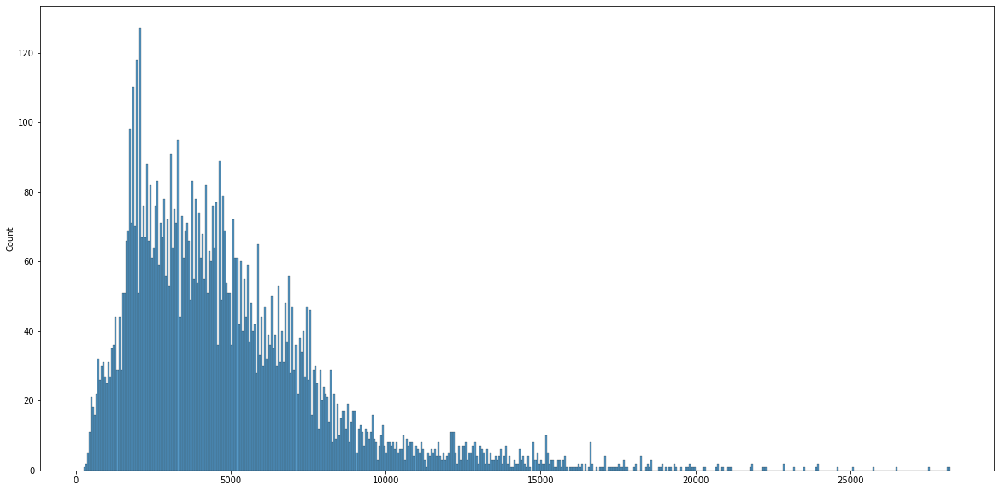

In [10]:
_len = [x/RATE for x in sl]

plt.figure(figsize=(20,10))
sb.histplot(data=sl, bins=500)

<AxesSubplot:ylabel='Count'>

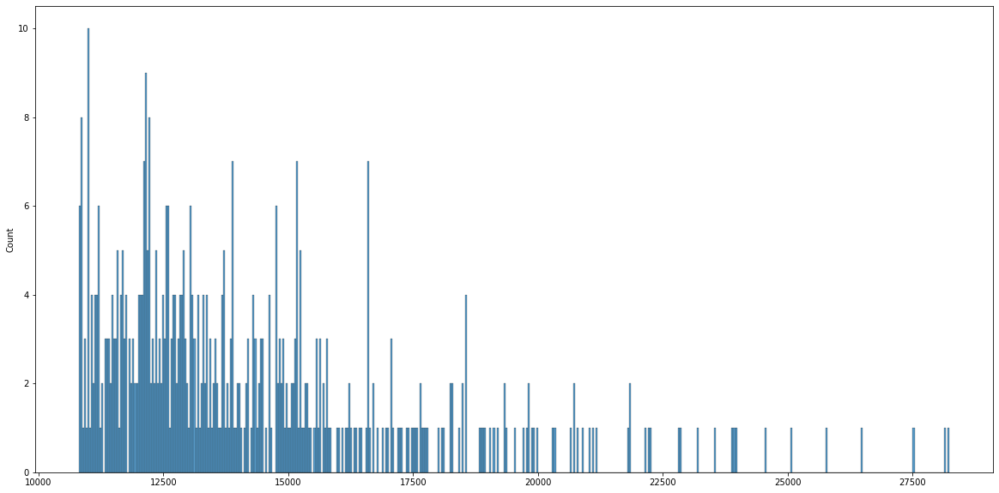

In [11]:
import heapq
num = 500

plt.figure(figsize=(20,10))
sb.histplot(data=heapq.nlargest(num, sl), bins=num)

In [12]:
n = sl.index(max(sl))
n

4748

In [13]:
print('Mean:', np.mean(sl))
print('Median:', np.median(sl))
print('Std:', np.std(sl))
print('Max:', np.max(sl))
print('Min:', np.min(sl))
print('Range:', np.max(sl) - np.min(sl))
print('Variance:', np.var(sl))
p = 99
print(f'{p}th percentile:', np.percentile(sl, p))
print(len(sl) - (len(sl) * (p /100)))

Mean: 4950.452699356117
Median: 4224.0
Std: 3357.068725252544
Max: 28240
Min: 256
Range: 27984
Variance: 11269910.426068742
99th percentile: 17008.0
80.76000000000022


In [15]:
cutoff_idx = []
for i, x in enumerate(sl):
    if x > max_length:
        cutoff_idx.append(i)
len(cutoff_idx)

7

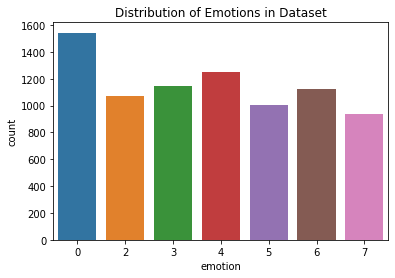

In [36]:
# gm = sb.countplot(x='emotion', data=df_train)
# gm.title.set_text('Distribution of Emotions in Train Set')
# plt.show()

# gm = sb.countplot(x='emotion', data=df_val)
# gm.title.set_text('Distribution of Emotions in Validation Set')
# plt.show()

# gm = sb.countplot(x='emotion', data=df_test)
# gm.title.set_text('Distribution of Emotions in Test Set')
# plt.show()

g = sb.countplot(x='emotion', data=df)
g.title.set_text('Distribution of Emotions in Dataset')
plt.show()
# g = sb.catplot(x='emotion', col='gender', data=d, kind='count', height=4, aspect=1.5, hue='gender')
# g.fig.suptitle("Sample distribution")
# g.fig.subplots_adjust(top=.8)
# plt.show()

In [37]:
print('Max sample length (will be used for padding later): ', max_length)
print('Sequential Values for each feature (rounded): ', round((max_length+1)/256))

Max sample length (will be used for padding later):  24000
Sequential Values for each feature (rounded):  94


#### ERD

In [20]:
def waveplot(data, sr, title):
    plt.figure(figsize=(12, 4))
    plt.title(title)
    lrd.waveshow(data, sr=sr)
    plt.show()

def spectograph(data, sr, title):
    x = lr.stft(data)
    xdb = lr.amplitude_to_db(abs(x))
    plt.figure(figsize=(12, 4))
    plt.title(title)
    lrd.specshow(xdb, sr=sr, x_axis='time', y_axis='hz')
    plt.colorbar()

def getPath(EType):
    return np.array(df['sound'][df['emotion'] == EType])[0]

def getInfo(EType):
    path = getPath(EType)
    data, sr = lr.load(path)
    waveplot(data, sr, EType)
    spectograph(data, sr, EType)


In [18]:
bruh, b = lr.load(df['sound'][1129], sr=RATE, res_type='kaiser_fast')
bruh= lr.effects.trim(bruh, top_db=25)
Audio(bruh[0][:48000], b, False) # doesn't sound too bad

In [19]:
# Cutoff test
import random

def play_rand_cutoff_audio():
    idx = random.choice(cutoff_idx)
    bruh, b = lr.load(df['sound'][idx], sr=RATE, res_type='kaiser_best')
    bruh= lr.effects.trim(bruh, top_db=25)
    return bruh[0][:48000]
    # Audio(bruh[0][:48000], b, False) # doesn't sound too bad

Audio(play_rand_cutoff_audio(), RATE, False)

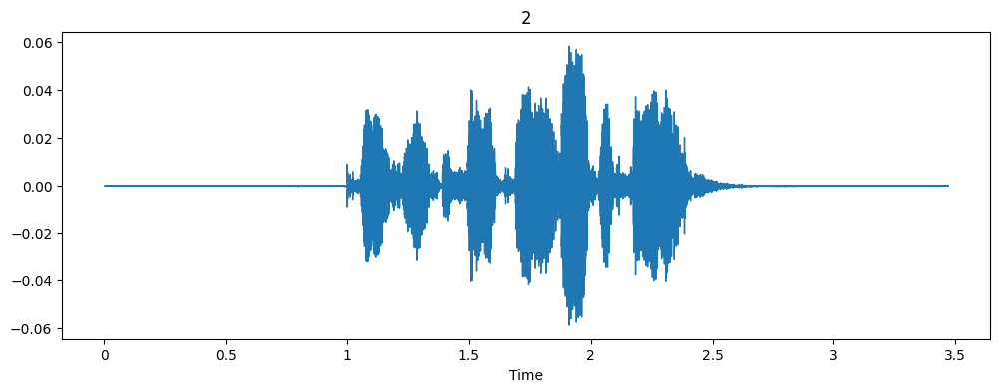

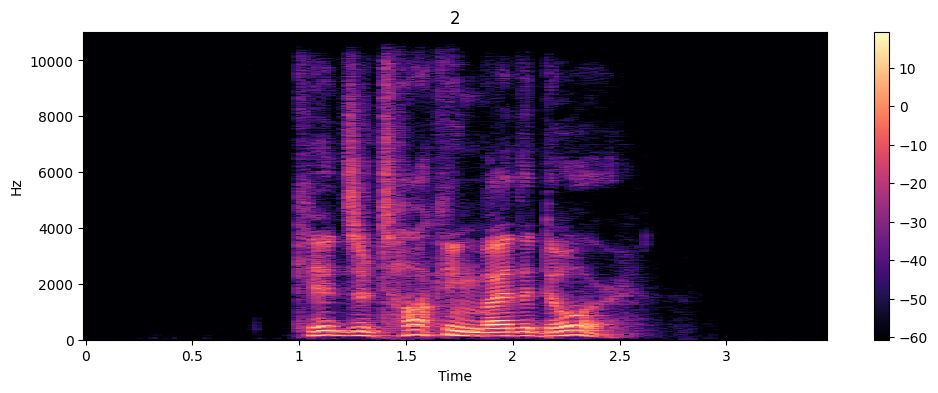

In [20]:
EType = 'happy'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

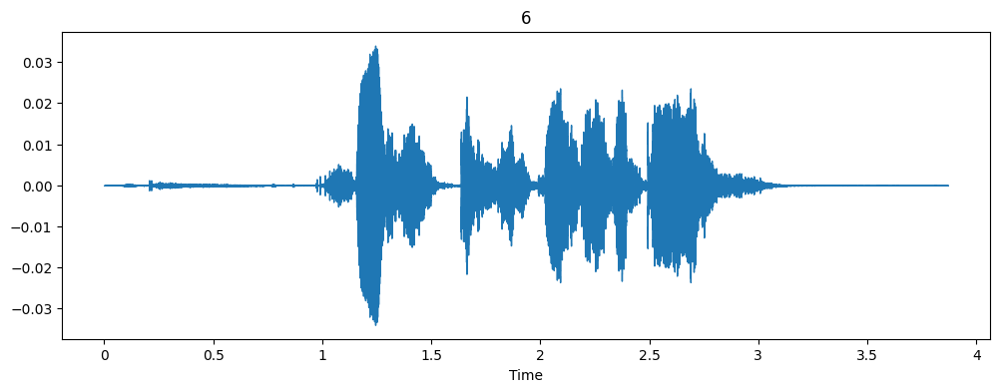

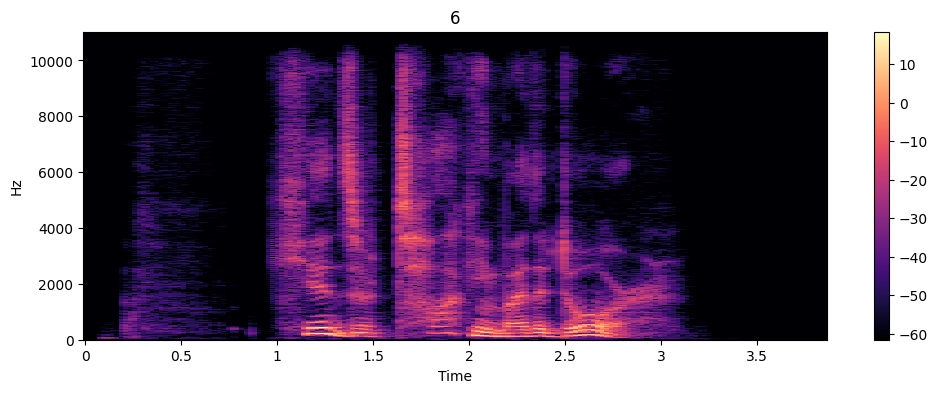

In [21]:
EType = 'disgust'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

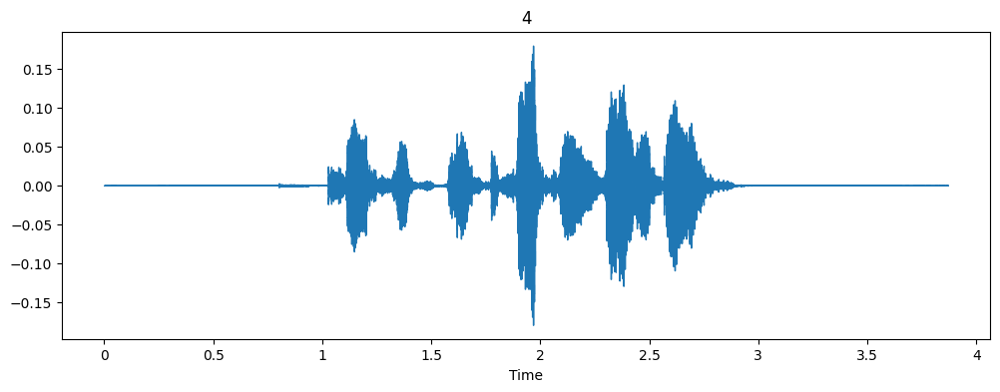

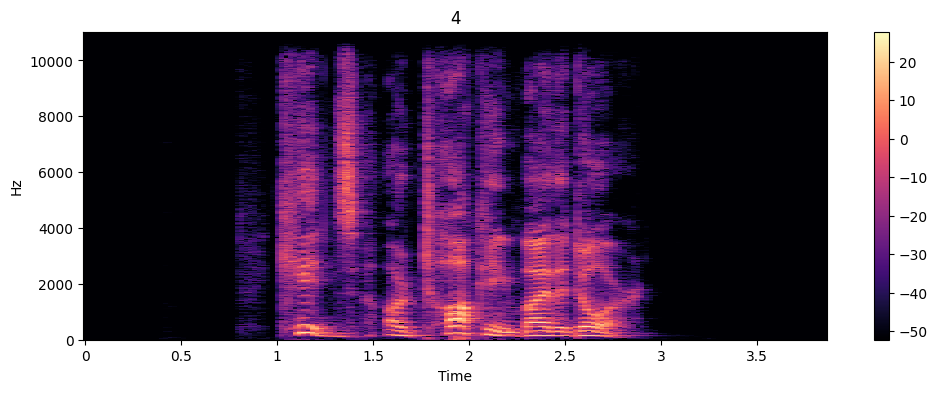

In [22]:
EType = 'angry'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

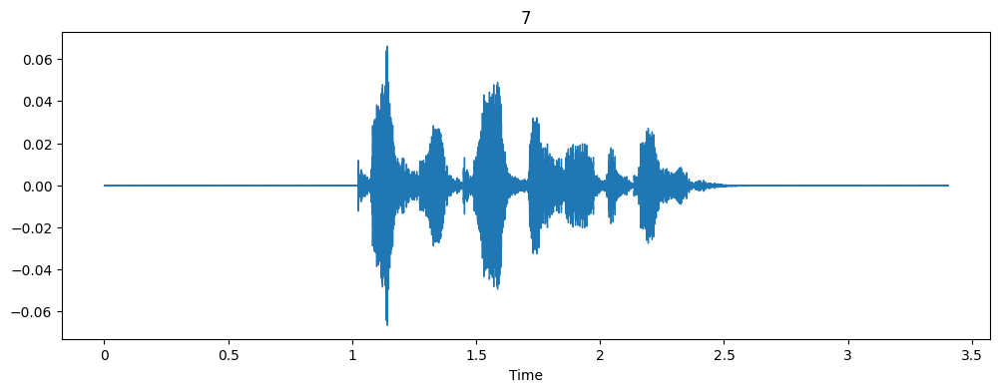

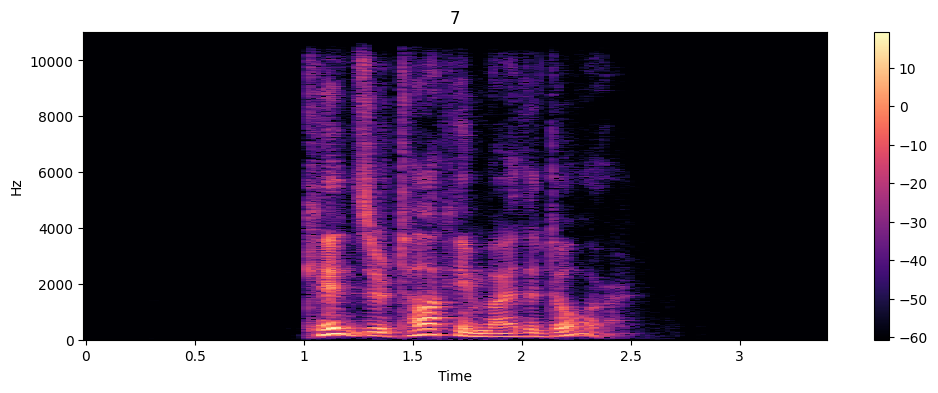

In [23]:
EType = 'surprise'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

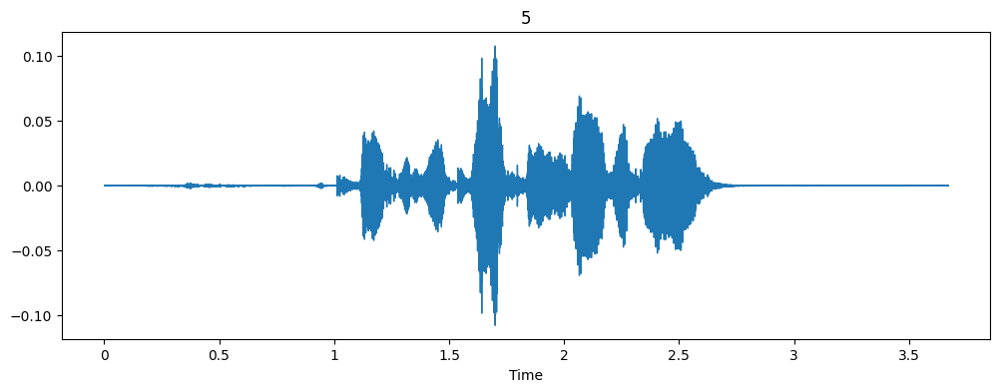

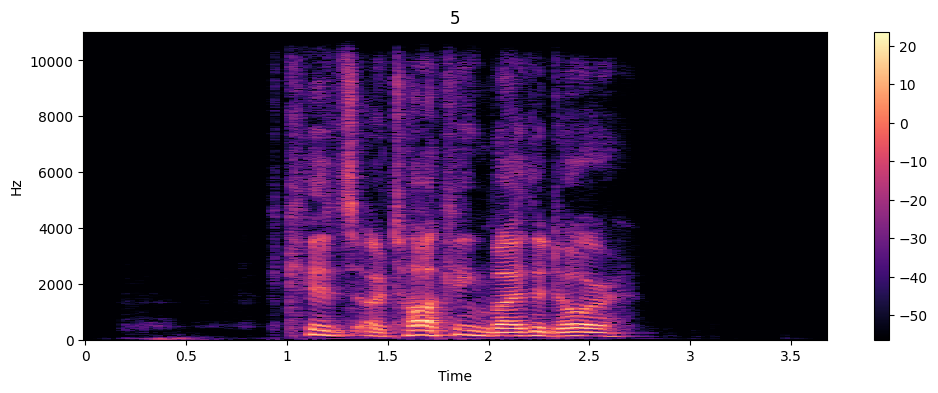

In [24]:
EType = 'fear'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

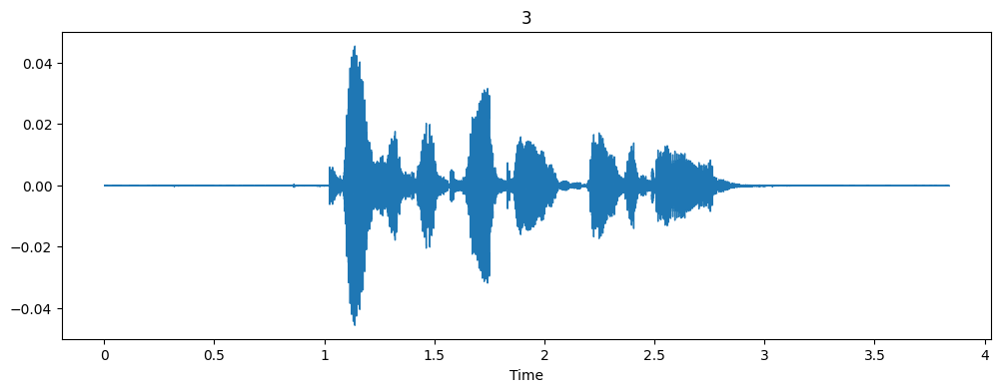

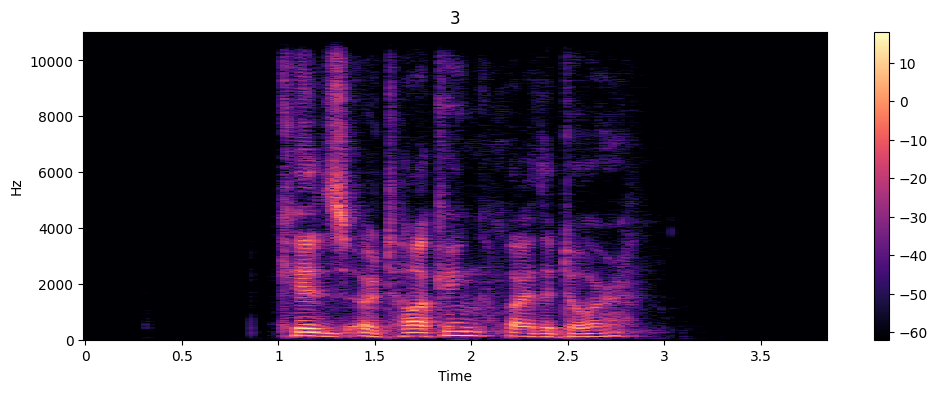

In [25]:
EType = 'sad'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

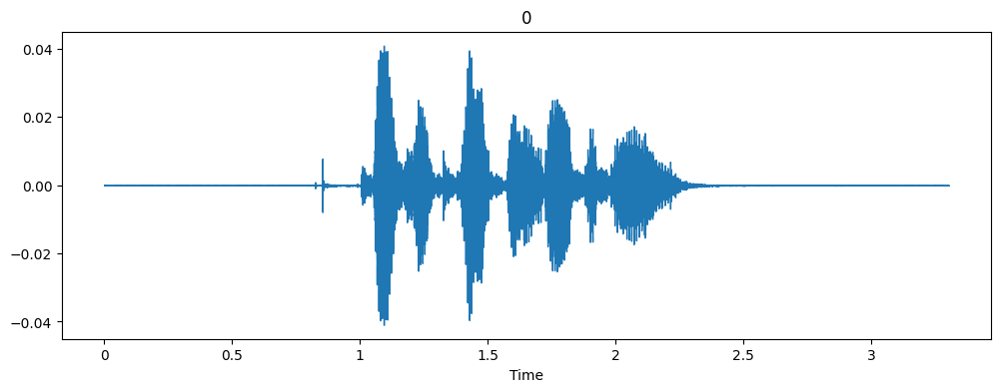

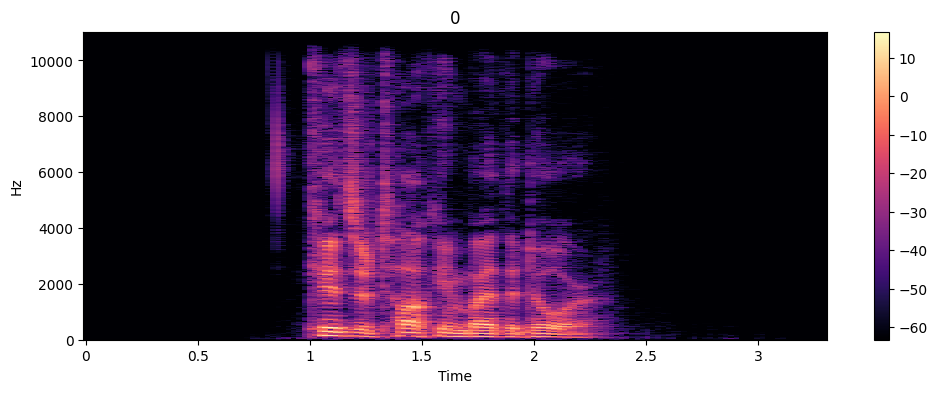

In [26]:
EType = 'neutral'
getInfo(get_emotion_identifier(EType))
Audio(getPath(get_emotion_identifier(EType)))

# Data Augmentation

In [18]:
# ratio: A. A. Abdelhamid et al., “Robust Speech Emotion Recognition Using CNN+LSTM Based on Stochastic Fractal Search Optimization Algorithm,” IEEE Access, vol. 10, pp. 49265–49284, 2022, doi: 10.1109/ACCESS.2022.3172954.
def noise(data):
    ratio = 0.015
    noise_amp = ratio*np.random.uniform()*np.amax(data)
    n = np.random.randn(len(data))
    # data = data + noise_amp*np.random.normal(size=data.shape[0])
    data = data + noise_amp*n
    return data

def stretch(data, rate=0.8):
    return lr.effects.time_stretch(data, rate)

def shift(data):
    shift_range = int(np.random.uniform(low=-5, high = 5)*1000)
    return np.roll(data, shift_range)

def pitch(data, sampling_rate, pitch_factor=0.7):
    return lr.effects.pitch_shift(data, sampling_rate, pitch_factor)

In [19]:
def spec_augment(spec: np.ndarray, num_mask=2, 
                 freq_masking_max_percentage=0.15, time_masking_max_percentage=0.15):

    spec = spec.copy()
    for i in range(num_mask):
        all_frames_num, all_freqs_num = spec.shape
        freq_percentage = random.uniform(0.0, freq_masking_max_percentage)
        
        num_freqs_to_mask = int(freq_percentage * all_freqs_num)
        f0 = np.random.uniform(low=0.0, high=all_freqs_num - num_freqs_to_mask)
        f0 = int(f0)
        spec[:, f0:f0 + num_freqs_to_mask] = 0

        time_percentage = random.uniform(0.0, time_masking_max_percentage)
        
        num_frames_to_mask = int(time_percentage * all_frames_num)
        t0 = np.random.uniform(low=0.0, high=all_frames_num - num_frames_to_mask)
        t0 = int(t0)
        spec[t0:t0 + num_frames_to_mask, :] = 0
    
    return spec

## Data Augmentation Exhibition

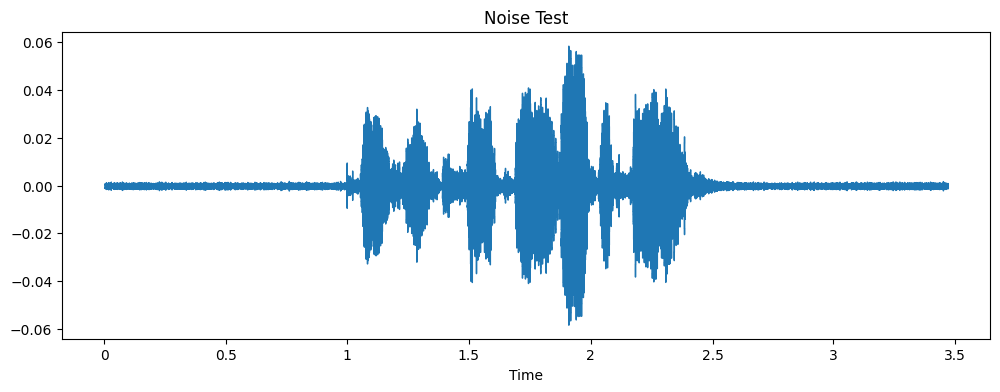

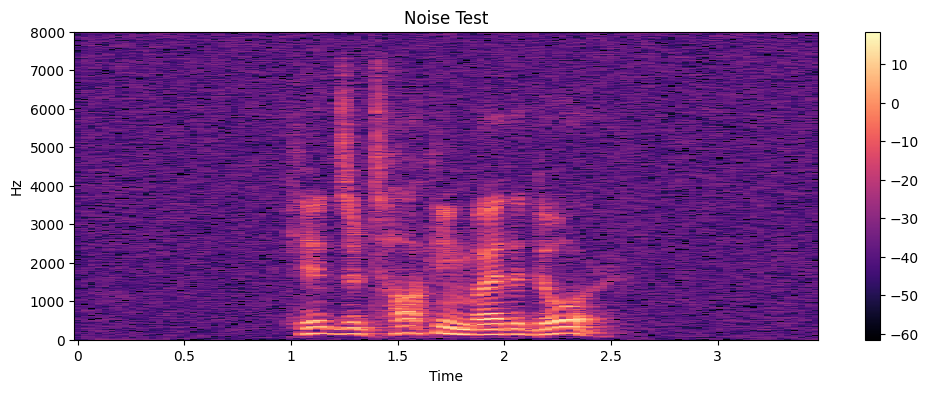

In [29]:
path = getPath(get_emotion_identifier('happy'))
data, sr = lr.load(path, RATE)
x = noise(data)
waveplot(x, sr, 'Noise Test')
spectograph(x, sr, 'Noise Test')
Audio(x, sr, False)

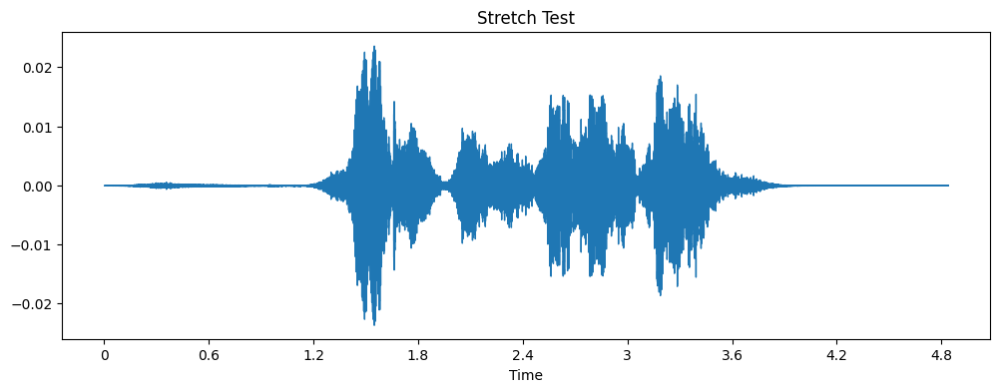

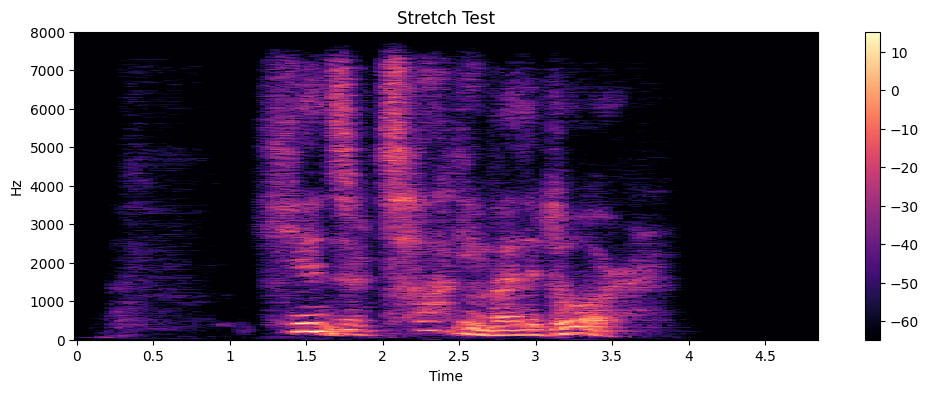

In [30]:
path = getPath(get_emotion_identifier('disgust'))
data, sr = lr.load(path, sr=RATE)
x = stretch(data)
waveplot(x, sr, 'Stretch Test')
spectograph(x, sr, 'Stretch Test')
Audio(x, sr, False)

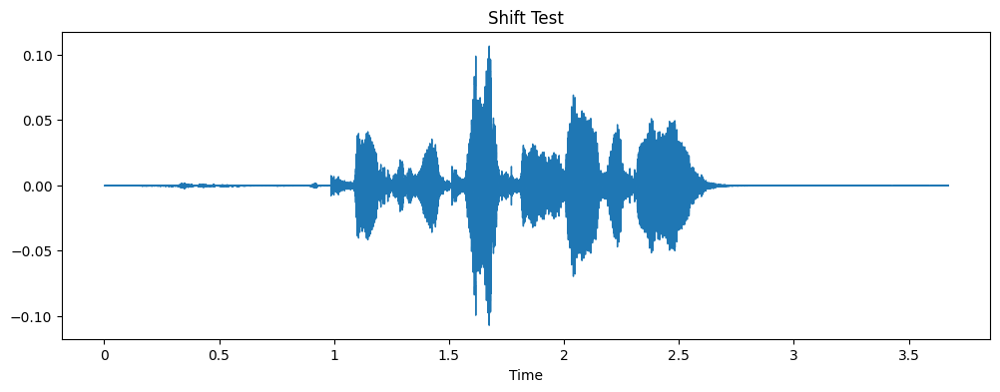

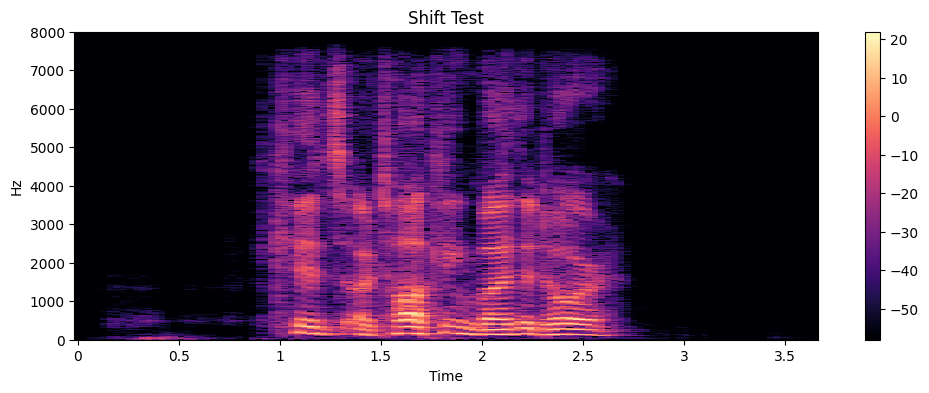

In [31]:
path = getPath(get_emotion_identifier('fear'))
data, sr = lr.load(path, RATE)
x = shift(data)
waveplot(x, sr, 'Shift Test')
spectograph(x, sr, 'Shift Test')
Audio(x, RATE, False)

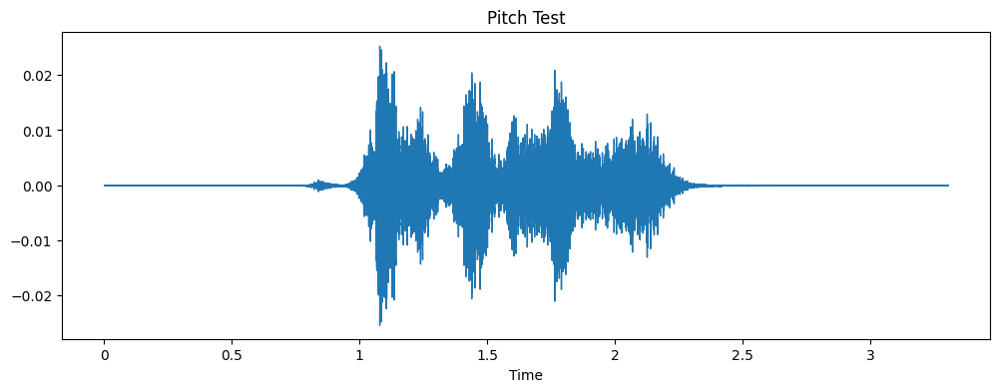

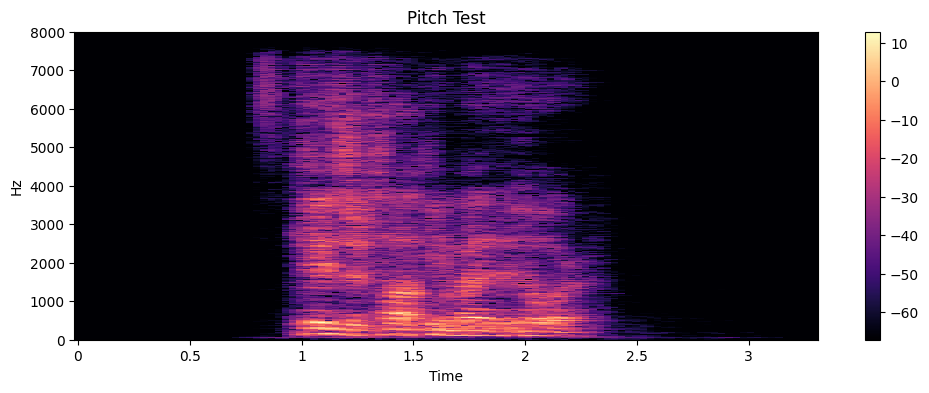

In [32]:
path = getPath(get_emotion_identifier('neutral'))
data, sr = lr.load(path, RATE)
x = pitch(data, sr)
waveplot(x, sr, 'Pitch Test')
spectograph(x, sr, 'Pitch Test')
Audio(x, sr, False)

In [33]:
## Shuffling
# d = d.sample(frac=1).reset_index(drop=True)
# d.head()

# Pre-processing

In [34]:
# def find_biggest_length(files):

#     sample_lengths = []

#     for file in tqdm(files):

#         # Load the audio file.
#         rawsound = AudioSegment.from_file(file) 

#         # Normalize the audio to +5.0 dBFS.
#         normalizedsound = effects.normalize(rawsound, headroom = 0) 
    
#         # Transform the normalized audio to np.array of samples.
#         data = np.array(normalizedsound.get_array_of_samples(), dtype = 'float32')
#         xt, index = lr.effects.trim(data, top_db=30)

#         sample_lengths.append(len(xt)) # Unaugmented length


#         noisy_data = noise(data)
#         xt, index = lr.effects.trim(noisy_data, top_db=30) 
#         sample_lengths.append(len(xt)) # Noisy length


#         new_data = stretch(data)
#         stretched_and_pitched_data = pitch(new_data, sr)
#         xt, index = lr.effects.trim(stretched_and_pitched_data, top_db=30)
#         sample_lengths.append(len(xt)) # Stretch and pitch length

#     return np.max(sample_lengths)

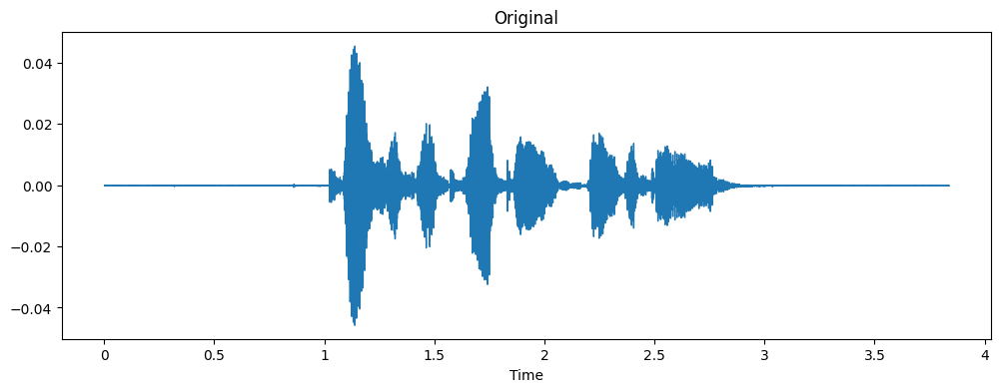

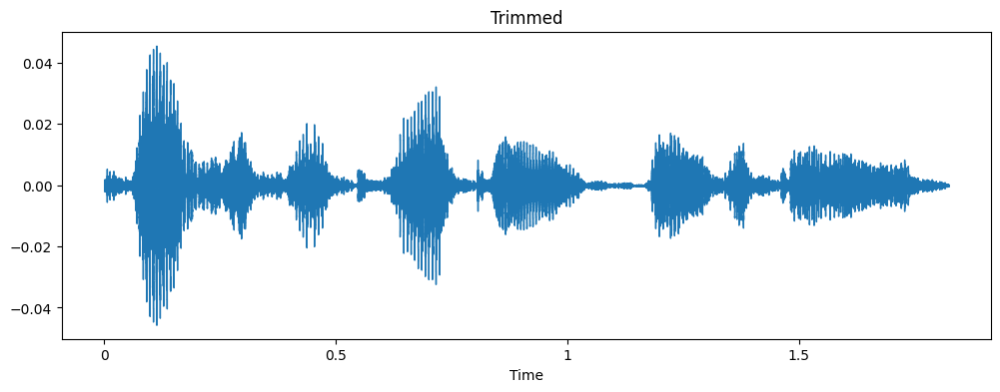

In [35]:
data, sr = lr.load(getPath(3), RATE)
waveplot(data, sr, 'Original')
data_t = lr.effects.trim(data, top_db=TOP_DB)
waveplot(data_t[0], sr, 'Trimmed')
Audio(data_t[0], sr, False)

In [21]:
def pre_process(path, insertNoise=False, specAug=False):

    xt, sr = lr.load(path = path, sr=RATE, res_type='kaiser_best')

    # # Load the audio file.
    # rawsound = AudioSegment.from_file(path) 

    # # Normalize the audio to +5.0 dBFS.
    # normalizedsound = effects.normalize(rawsound, headroom = 0) 
    
    # # Transform the normalized audio to np.array of samples.
    # normal_x = np.array(normalizedsound.get_array_of_samples(), dtype = 'float32')

    # if insertNoise:
    #     data = noise(data)

    # if specAug:
    #     # spec aug here
    #     data = stretch(data)
    #     data = pitch(data, sr)
    #     data = shift(data)



    # Trim silence from the beginning and the end.
    # xt, index = lr.effects.trim(data, top_db=TOP_DB)

    # Pad for duration equalization.
    if len(xt) > max_length:
        data = xt[:max_length]
    else:
        data = np.pad(xt, (0, max_length-len(xt)), 'constant')


    # Noise reduction.
    # final_x = nr.reduce_noise(padded_x, sr=sr)

    return data, sr

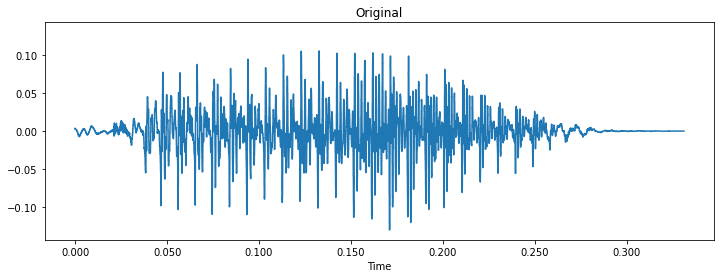

24000


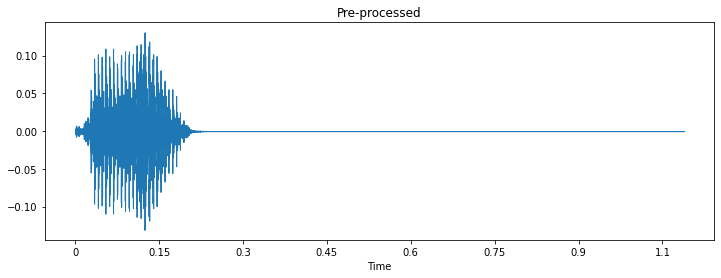

In [38]:
import random
x = df['sound'][random.randint(0, len(df['sound'])-1)]
data, sr = lr.load(x)
waveplot(data, sr, 'Original')
data_t = pre_process(x)
print(len(data_t[0]))
waveplot(data_t[0], sr, 'Pre-processed')

(128, 47)
32


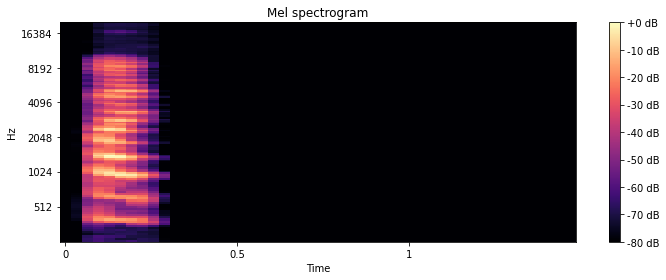

In [39]:
# data, sr = lr.load(df['sound'][0], RATE)
data, sr = pre_process(df['sound'][random.randint(0, len(df['sound'])-1)])
mel = lr.feature.melspectrogram(y=data, sr=sr, hop_length=512, n_mels=128, n_fft=2048)
print(mel.shape)
print(RATE//hop_length + 1)
S_db = lr.power_to_db(mel, ref=np.max)
plt.figure(figsize=(10, 4))
lr.display.specshow(S_db, y_axis='mel', x_axis='time', sr=sr, fmax=20000, fmin=20)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel spectrogram')
plt.tight_layout()

(128, 47)


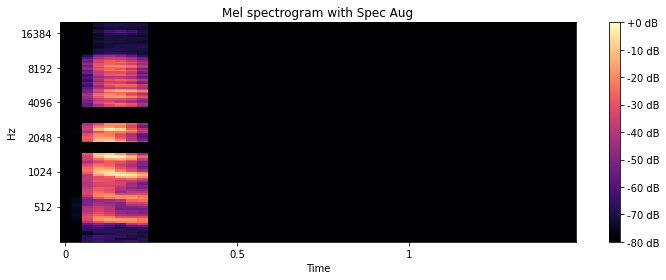

In [40]:
mel_a = spec_augment(mel)
print(mel_a.shape)
S_db = lr.power_to_db(mel_a, ref=np.max)
plt.figure(figsize=(10, 4))
lr.display.specshow(S_db, y_axis='mel', x_axis='time', sr=sr, fmax=20000, fmin=20)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel spectrogram with Spec Aug')
plt.tight_layout()

# Feature Extraction

In [43]:
def get_features(path):
    data, sr = pre_process(path)
    # data_n, sr = pre_process(path, insertNoise=True)

    data1 =  extract_features(data, sr)
    # data2 =  extract_features(data_n, sr)
    # data3 =  extract_features(data, sr)

    return data1

def extract_features(data, sr, doSpecAug=False):

    # result = np.array([])


    # MelSpectogram
    # mel = lr.feature.melspectrogram(y=data, sr=sr, hop_length=hop_length, n_mels=128, n_fft=window_size)
    # result = np.hstack((result, mel))

    # Sub band spectral contrast
    # sc = lr.feature.spectral_contrast(data, hop_length=hop_length)

    # Tonnetz
    # tonnetz = lr.feature.tonnetz(data, sr=sr, hop_length=hop_length)

    # ZCR
    # zcr = np.mean(lr.feature.zero_crossing_rate(y=data).T, axis=0)
    # result=np.hstack((result, zcr)) 

    # Chroma_stft
    # stft = np.abs(lr.stft(data, hop_length=hop_length ))
    # chroma_stft = lr.feature.chroma_stft(S=stft, sr=sr, hop_length=hop_length, n_chroma=13)
    # result = np.hstack((result, chroma_stft)) 

    # MFCC
    mfcc = lr.feature.mfcc(y=data, sr=sr, n_mfcc=13, hop_length=hop_length)
    # result = np.hstack((result, mfcc)) 

    # Root Mean Square Value
    # rms = np.mean(lr.feature.rms(y=data).T, axis=0)
    # result = np.hstack((result, rms)) 

    # SpecAugment
    # if doSpecAug:
    #     mel = spec_augment(mel)

    
    
    # return mel, chroma_stft, mfcc, tonnetz, sc
    return mfcc


In [50]:
def get_feature_dataframe(df: pd.DataFrame, isTrainSet=False):

    X_features = []
    y = []

    f1 = []
    f2 = []
    f3 = []
    f4 = []
    f5 = []

    for _, row in tqdm(df.iterrows(), total=len(df)):
        # mel, chroma_stft, mfcc, tonnetz, sc = get_features(row['sound'])
        # f1.append(mel)
        # f2.append(chroma_stft)
        # f3.append(mfcc)
        # f4.append(tonnetz)
        # f5.append(sc)
        # y.append(row['emotion'])
        mel1 = get_features(row['sound'])

        f1.append(mel1)
        y.append(row['emotion'])

        # if isTrainSet:
        #     f2.append(mel2)
        #     y.append(row['emotion'])


    f1_np = np.asarray(f1).astype('float32')
    # f1_np = np.expand_dims(f1_np, -1)

    # if isTrainSet:
    #     f2_np = np.asarray(f2).astype('float32')
    #     f2_np = np.expand_dims(f2_np, -1)
    # f3_np = np.asarray(f3).astype('float32')
    # f3_np = np.expand_dims(f3_np, -1)

    # f4_np = np.asarray(f4).astype('float32')
    # f5_np = np.asarray(f5).astype('float32')

    # print('Final:')
    # print(f1_np.shape)
    # print(f2_np.shape)
    # print(f3_np.shape)
    # print(f4_np.shape)
    # print(f5_np.shape)

    # X_features = np.concatenate((f1_np, f2_np, f3_np, f4_np, f5_np), axis=1)

    y = np.asarray(y).astype('int8')
    # y = np.expand_dims(y, axis=1)
    # print(y.shape)

    if isTrainSet:
        X_features = np.concatenate((f1_np, f2_np), axis=0)
        X_features, y = shuffle(X_features, y)
    else:
        X_features, y = shuffle(f1_np, y)


    print(X_features.shape, y.shape)

    data = {
        'features': X_features,
        'emotion': y
    }


    return data

In [45]:
bruh = get_feature_dataframe(df[:3])

3it [00:00, 84.85it/s]

(3, 13, 47) (3,)


# Input split

In [46]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split
encoder = OneHotEncoder()

In [48]:
ds = 'ravdess'
feat_ex_technique = 'chunk'

# Defines ratios, w.r.t. whole dataset.
ratio_train = 0.7
ratio_val = 0.15
ratio_test = 0.15

def get_splits(d):
    # Produces test split.
    remaining, test = train_test_split(
        d, test_size=ratio_test, stratify=d['emotion'])

    # Adjusts val ratio, w.r.t. remaining dataset.
    ratio_remaining = 1 - ratio_test
    ratio_val_adjusted = ratio_val / ratio_remaining

    # Produces train and val splits.
    train, val = train_test_split(
        remaining, test_size=ratio_val_adjusted, stratify=remaining['emotion'])

    return train, val, test


In [ ]:
# trm, vm, tem = get_splits(d_m)
# trm.shape, vm.shape, tem.shape

((432, 2), (180, 2), (108, 2))

In [ ]:
# trf, vf, tef = get_splits(d_f)
# trf.shape, vf.shape, tef.shape

((432, 2), (180, 2), (108, 2))

In [ ]:
# train = pd.concat([trm, trf])
# val = pd.concat([vm, vf])
# test = pd.concat([tem, tef])
# train.shape, val.shape, test.shape

((864, 2), (360, 2), (216, 2))

In [49]:
df_train, df_val, df_test = get_splits(df)
df_train.shape, df_val.shape, df_test.shape

((5652, 2), (1212, 2), (1212, 2))

In [51]:
df_train = get_feature_dataframe(df_train)
df_val = get_feature_dataframe(df_val)
df_test = get_feature_dataframe(df_test)

100%|██████████| 5652/5652 [00:26<00:00, 209.79it/s]


(5652, 13, 47) (5652,)


100%|██████████| 1212/1212 [00:05<00:00, 214.98it/s]


(1212, 13, 47) (1212,)


100%|██████████| 1212/1212 [00:05<00:00, 225.01it/s]

(1212, 13, 47) (1212,)


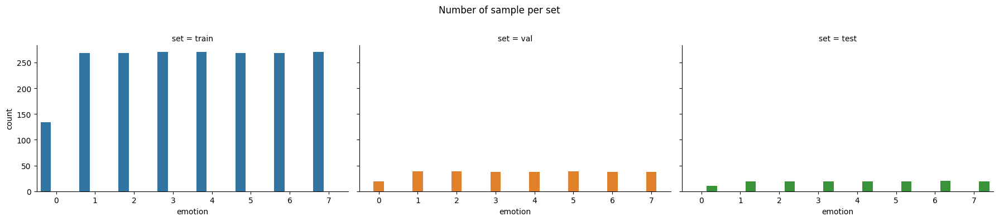

In [82]:
df_plot = pd.DataFrame(columns=['set', 'emotion'])

x = pd.DataFrame(len(df_train['features']) * ['train'])
y = pd.DataFrame(len(df_val['features']) * ['val'])
z = pd.DataFrame(len(df_test['features']) * ['test'])

p = pd.DataFrame(df_train['emotion'])
q = pd.DataFrame(df_val['emotion'])
r = pd.DataFrame(df_test['emotion'])

df_plot['set'] = pd.concat([x ,y, z], axis=0, ignore_index=True)
df_plot['emotion'] = pd.concat([p, q, r], axis=0, ignore_index=True)

g = sb.catplot(x='emotion', col='set', data=df_plot, kind='count', hue='set', height=4, aspect=1.5)
g.fig.suptitle("Number of sample per set")
g.fig.subplots_adjust(top=.8)
plt.show()

In [52]:
save_path = f'./features/{ds}'
os.makedirs(save_path)

np.save(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_train', df_train['features'])
np.save(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_train_emo', df_train['emotion'])
np.save(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_val', df_val['features'])
np.save(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_val_emo', df_val['emotion'])
np.save(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_test', df_test['features'])
np.save(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_test_emo', df_test['emotion'])

In [53]:
x_train = np.load(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_train.npy')
y_train = np.load(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_train_emo.npy')
x_val = np.load(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_val.npy')
y_val = np.load(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_val_emo.npy')
x_test = np.load(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_test.npy')
y_test = np.load(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_test_emo.npy')

In [54]:
x_train.shape, y_train.shape, x_val.shape, y_val.shape, x_test.shape, y_test.shape

((5652, 13, 47), (5652,), (1212, 13, 47), (1212,), (1212, 13, 47), (1212,))

In [ ]:
# save_path = f'./features/{ds}'
# os.makedirs(save_path)

# df_train.to_csv(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_train.csv', index=False)
# df_val.to_csv(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_val.csv', index=False)
# df_test.to_csv(f'{save_path}/{ds}_{feat_ex_technique}_{ratio_train}-{ratio_val}-{ratio_test}_test.csv', index=False)

In [ ]:
# Load features from csv files.

# df_ft = pd.read_csv(f'./features/subesco/{ratio_train}-{ratio_val}-{ratio_test}/chroma_mfcc_mel_train.csv')

In [ ]:
#separating features and target outputs

# x_train = df_train.drop('emotion', axis = 1).values
# y_train = df_train['emotion'].values

# x_val = df_val.drop('emotion', axis = 1).values
# y_val = df_val['emotion'].values

# x_test = df_test.drop('emotion', axis = 1).values
# y_test = df_test['emotion'].values

In [ ]:
# x_train.shape, y_train.shape, x_val.shape, y_val.shape, x_test.shape, y_test.shape

((10500, 180), (10500,), (1750, 180), (1750,), (1750, 180), (1750,))

In [ ]:
# scaler = StandardScaler()
# x_train = scaler.fit_transform(x_train)
# x_test = scaler.transform(x_test)
# x_val = scaler.transform(x_val)
# x_train.shape, y_train.shape, x_test.shape, y_test.shape, x_val.shape, y_val.shape

((10500, 180), (10500,), (1750, 180), (1750,), (1750, 180), (1750,))

In [ ]:
# y_train = encoder.fit_transform(np.array(y_train).reshape(-1,1)).toarray()
# y_val = encoder.fit_transform(np.array(y_val).reshape(-1,1)).toarray()
# y_test = encoder.fit_transform(np.array(y_test).reshape(-1,1)).toarray()

In [ ]:
# x_train = np.expand_dims(x_train, axis=2)
# x_test = np.expand_dims(x_test, axis=2)
# x_val = np.expand_dims(x_val, axis=2)
# x_train.shape, y_train.shape, x_test.shape, y_test.shape, x_val.shape, y_val.shape

((10500, 180, 1),
 (10500, 7),
 (1750, 180, 1),
 (1750, 7),
 (1750, 180, 1),
 (1750, 7))